# Description
Testing the tiling of multiple files and the permutations of +/- lon/lat to make sure that the code can crop and center the data properly.

In [20]:
using Plots
using Gnuplot

In [21]:
include("./src/triangles_hgt.jl")
include("./src/parse_hgt.jl")
include("./src/slicing.jl")
include("./src/stl_format.jl")

write_stl_binary (generic function with 1 method)

# Tiling multiple files

In [23]:
center=[36.082752, -112.041425] # part of the grand canyon
box_size=5000 # resulting box will be box_size+1 by box_size+1 in size
coords = center_bounds_coords(center,box_size,box_size)
filename = get_filename_from_coords(center)
tiles,fn_tiles = get_tile_filenames_from_coords(coords,"./hgt_data/")
println(fn_tiles)

["./hgt_data/n35w113.hgt", "./hgt_data/n35w112.hgt", "./hgt_data/n36w113.hgt", "./hgt_data/n36w112.hgt"]


In [25]:
# get rid of the overlapping rows/columns
# each file will overlap with the previous tile so we either remove the first or remove the last row
for i in 1:size(tiles,1)
    for j in 1:size(tiles,2)-1
        tiles[i,j] = tiles[i,j][:,1:end .!=end]
    end
end

for j in 1:size(tiles,2)
    for i in 1:size(tiles,1)-1
        tiles[i,j] = tiles[i,j][1:end .!=end,:]
    end
end

In [26]:
# stack the tiles horizontally, then vertically

hcatted = Array{Array{Int16,2}}(undef,0)
for i in 1:size(tiles[:,1],1)
    append!(hcatted,[hcat(tiles[i,:]...)])
end

master_tile = vcat(hcatted...)

7200×7200 Array{Int16,2}:
 1952  1957  1965  1975  1988  1999  …  1695  1696  1696  1697  1696  1696
 1959  1960  1963  1972  1983  1996     1694  1694  1695  1696  1697  1697
 1967  1964  1964  1965  1974  1987     1693  1693  1694  1696  1696  1696
 1976  1972  1970  1969  1972  1978     1693  1693  1694  1695  1695  1694
 1988  1985  1981  1979  1976  1976     1694  1695  1695  1695  1695  1694
 2003  1998  1995  1991  1985  1983  …  1696  1697  1697  1696  1696  1696
 2016  2010  2008  2004  1999  1993     1696  1698  1697  1696  1695  1696
 2030  2024  2019  2017  2012  2005     1695  1696  1696  1694  1693  1693
 2041  2038  2031  2027  2022  2016     1694  1694  1693  1692  1691  1691
 2047  2044  2041  2037  2033  2028     1692  1693  1692  1691  1690  1691
 2051  2048  2046  2044  2041  2038  …  1692  1692  1692  1691  1691  1691
 2050  2048  2047  2045  2044  2043     1692  1692  1691  1690  1690  1691
 2044  2042  2041  2041  2043  2045     1692  1691  1690  1689  1690  1690

In [27]:
sliced_data = slice_data(master_tile,coords) 

5001×5001 Array{Int16,2}:
 2003  1999  1995  1995  1998  2001  …  1697  1698  1700  1700  1699  1698
 2011  2006  2001  1998  1998  2000     1696  1696  1697  1697  1697  1696
 2016  2012  2007  2002  2000  2000     1695  1694  1695  1694  1694  1695
 2018  2014  2011  2007  2003  2001     1694  1694  1694  1693  1693  1694
 2022  2020  2015  2012  2010  2005     1694  1694  1693  1692  1693  1693
 2034  2030  2027  2023  2019  2014  …  1694  1694  1694  1693  1692  1692
 2047  2043  2041  2037  2029  2019     1693  1693  1693  1692  1691  1691
 2060  2058  2052  2045  2035  2024     1692  1691  1691  1690  1690  1689
 2070  2066  2059  2048  2036  2026     1691  1692  1691  1690  1690  1690
 2077  2068  2059  2046  2034  2030     1691  1691  1691  1691  1691  1690
 2076  2063  2048  2039  2034  2033  …  1690  1689  1690  1690  1690  1689
 2073  2060  2046  2039  2037  2037     1688  1687  1687  1688  1689  1688
 2068  2059  2049  2046  2044  2046     1687  1687  1686  1686  1687  1687

In [28]:
# write data to temporary binary file to plot with gnuplot which is slightly better for large amounts of data
data=sliced_data
(path,io) = mktemp()
for j in 1:size(data,1)
    for i in 1:size(data,2)
        write(io,convert(Int32,i))
        write(io,convert(Int32,j))
        write(io,convert(Int32,data[j,i]))
    end
end
close(io)

n = size(data,1)*size(data,2)

25010001

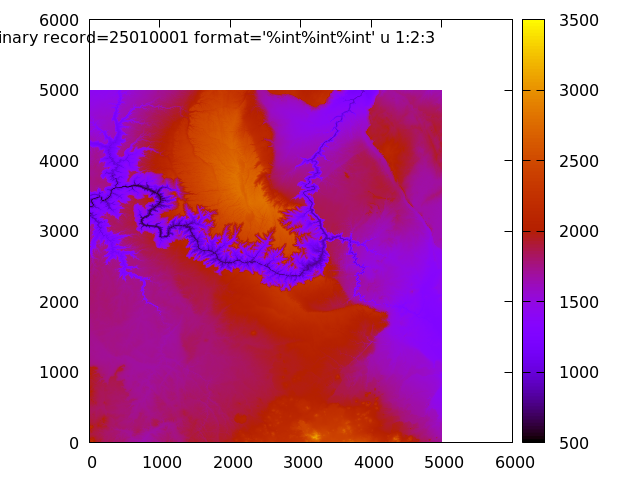

In [29]:
# plot using gnuplot... seems to work better for extra large plots
gpsource = " '$path'binary record=$n format='%int%int%int' u 1:2:3 "
@gp "set size ratio -1" "plot $gpsource with image"

# Permutations

## +,- Coordinates

In [30]:
center = [41.404607, -122.198942] # Mt. Shasta
box_size = 200 # size in integer arcsec
coords = center_bounds_coords(center,box_size,box_size)
filename = get_filename_from_coords(center)
data = parse_hgt(filename)
println(filename)

sliced_data = slice_data(data,coords)

hgt_data/n41w123.hgt


201×201 Array{Int16,2}:
 2594  2594  2587  2580  2579  2581  …  2601  2600  2599  2597  2597  2599
 2611  2614  2609  2600  2596  2597     2608  2607  2605  2605  2605  2605
 2628  2628  2630  2623  2618  2615     2618  2614  2611  2612  2611  2613
 2637  2643  2647  2649  2647  2640     2626  2622  2621  2622  2622  2621
 2654  2662  2668  2672  2672  2662     2635  2630  2628  2628  2627  2625
 2664  2674  2682  2686  2689  2687  …  2646  2642  2635  2629  2625  2617
 2674  2686  2691  2694  2699  2703     2647  2644  2638  2627  2615  2599
 2684  2693  2701  2707  2714  2720     2635  2633  2626  2618  2605  2591
 2694  2703  2714  2722  2730  2731     2624  2615  2607  2599  2591  2580
 2697  2710  2722  2730  2737  2743     2606  2596  2588  2577  2565  2558
 2700  2718  2726  2734  2746  2752  …  2597  2582  2568  2552  2534  2526
 2707  2721  2732  2745  2758  2763     2572  2559  2549  2537  2521  2511
 2715  2728  2741  2751  2759  2766     2556  2545  2534  2523  2510  2495
 

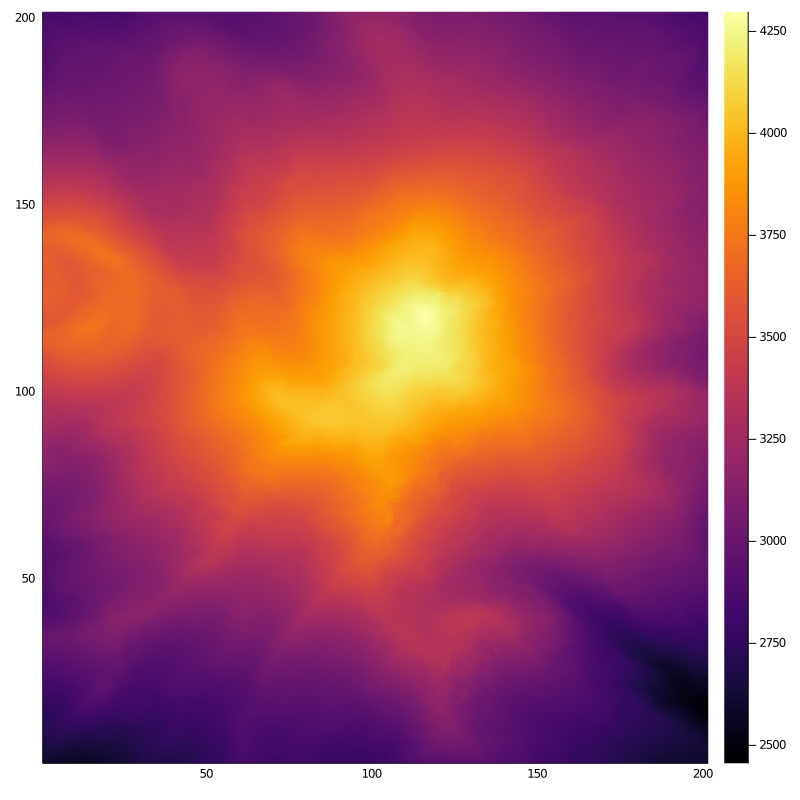

In [31]:
heatmap(sliced_data,
        size = (800, 800),
)

## -,- Coordinates

In [32]:
center = [-23.292418, -67.619542] # Cerro Pili
box_size = 50 # size in integer arcsec
coords = center_bounds_coords(center,box_size,box_size)
filename = get_filename_from_coords(center)
data = parse_hgt(filename)
println(filename)
sliced_data = slice_data(data,coords)

hgt_data/s24w068.hgt


51×51 Array{Int16,2}:
 5352  5364  5374  5388  5404  5413  …  5428  5424  5417  5410  5404  5391
 5365  5379  5394  5408  5421  5433     5442  5435  5433  5424  5414  5404
 5374  5389  5405  5419  5434  5447     5460  5451  5445  5436  5426  5413
 5384  5400  5413  5427  5444  5460     5472  5465  5456  5443  5433  5425
 5395  5409  5425  5440  5454  5469     5488  5481  5470  5456  5448  5439
 5407  5422  5438  5451  5466  5477  …  5510  5500  5484  5474  5464  5449
 5420  5435  5449  5461  5474  5487     5528  5516  5500  5488  5479  5465
 5432  5447  5455  5468  5483  5500     5541  5527  5517  5503  5491  5479
 5438  5452  5462  5475  5494  5515     5552  5537  5528  5520  5503  5491
 5444  5459  5474  5488  5509  5533     5562  5550  5539  5535  5524  5504
 5453  5469  5486  5502  5524  5547  …  5580  5566  5557  5546  5537  5518
 5466  5480  5495  5518  5542  5558     5599  5584  5570  5557  5548  5533
 5479  5493  5509  5523  5544  5563     5615  5606  5587  5568  5557  5539
   

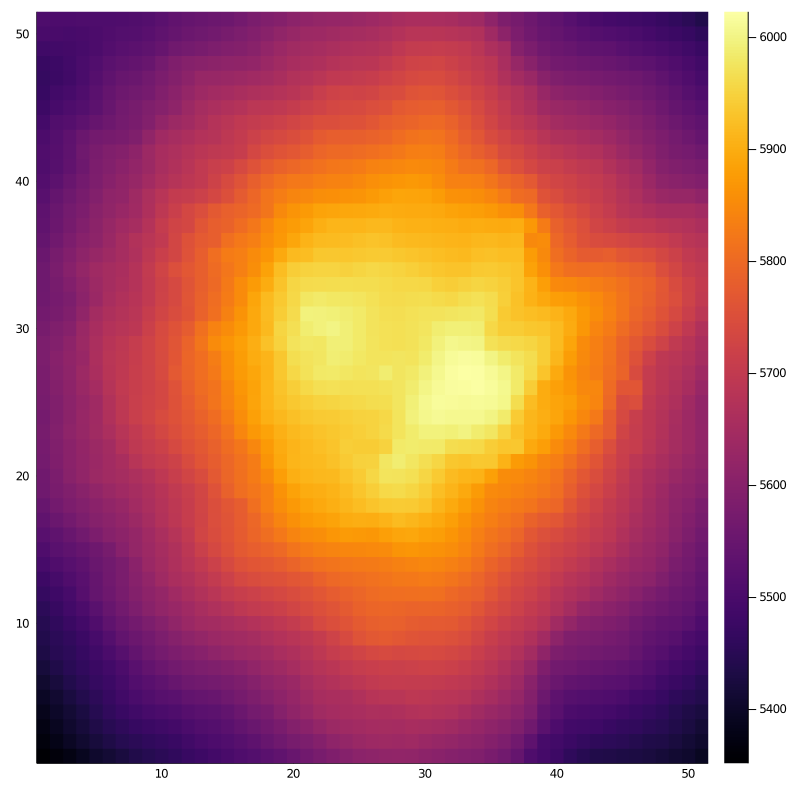

In [33]:
heatmap(sliced_data,
        size = (800, 800),
)

## -,+ Coordinates

In [34]:
center = [-33.935047, 18.389248] # Lions Head, Cape Town
box_size = 100 # size in integer arcsec
coords = center_bounds_coords(center,box_size,box_size)
filename = get_filename_from_coords(center)
data = parse_hgt(filename)
println(filename)

sliced_data = slice_data(data,coords)

hgt_data/s34e018.hgt


101×101 Array{Int16,2}:
 0  0  0   0  0  0   0   0   0   0   8  …  424  421  417  412  405  397  393
 0  0  0   0  0  0   0   0   0   0   7     412  405  399  396  388  381  377
 0  0  0   0  0  0   0   0   0   0   8     399  395  390  382  372  365  364
 0  0  0   0  0  0   0   0   0   0   8     390  385  378  366  359  358  358
 0  0  0   0  0  0   0   0   0   0  10     380  374  365  357  354  353  352
 0  0  0   0  0  0   0   0   0   0  12  …  371  365  359  353  348  345  341
 0  0  0   0  0  0   0   0   0   0  12     365  362  355  345  338  334  328
 0  0  0   0  0  0   0   0   0   9  12     363  359  350  335  328  323  316
 0  0  0   0  0  0   0   0   0  11  14     356  351  340  330  320  313  306
 0  0  0   0  0  0   0   0   8  11  13     347  340  332  323  313  305  300
 1  1  2   1  1  1   3   5   9  11  13  …  338  334  327  316  305  298  293
 1  2  2   2  2  4   6   8  11  13  16     328  324  320  308  298  291  287
 2  3  4   5  6  8  10  12  16  19  23     315  311 

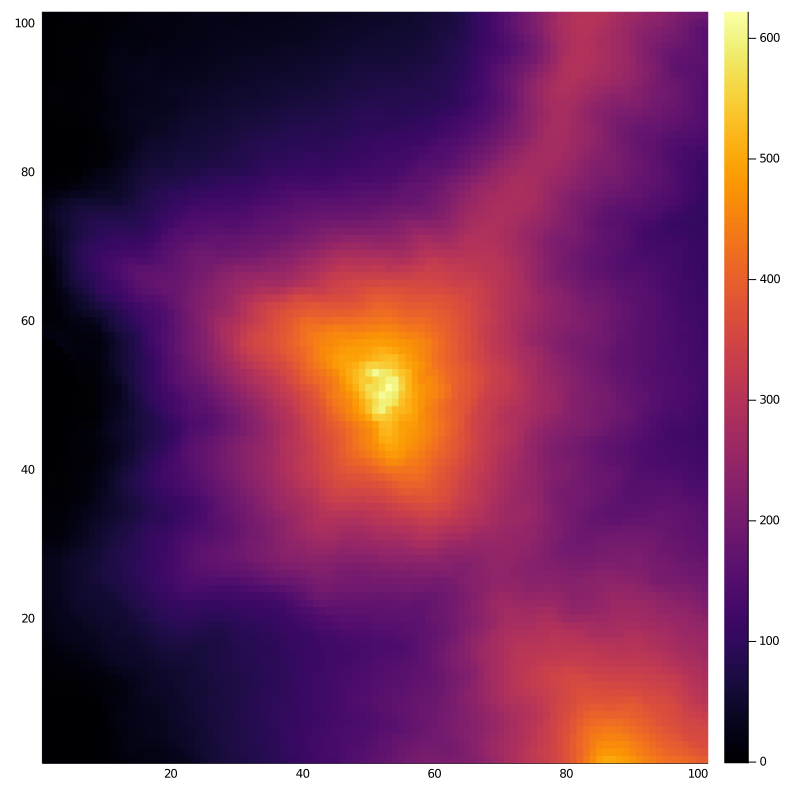

In [35]:
heatmap(sliced_data,
        size = (800, 800),
)

## +,+ Coordinates

In [36]:
center = [35.362729, 138.730627] # Mt. Fuji
box_size = 300 # size in integer arcsec
coords = center_bounds_coords(center,box_size,box_size)
filename = get_filename_from_coords(center)
data = parse_hgt(filename)
println(filename)

sliced_data = slice_data(data,coords)

hgt_data/n35e138.hgt


301×301 Array{Int16,2}:
 1321  1328  1333  1336  1338  1341  …  1627  1623  1620  1618  1616  1616
 1324  1330  1336  1339  1342  1343     1629  1626  1624  1621  1619  1615
 1325  1332  1338  1343  1344  1346     1634  1633  1630  1627  1622  1616
 1327  1331  1337  1342  1345  1347     1639  1637  1634  1630  1624  1618
 1329  1332  1336  1342  1345  1349     1643  1641  1637  1631  1625  1621
 1335  1335  1338  1344  1348  1352  …  1646  1644  1641  1634  1628  1624
 1338  1340  1342  1345  1349  1353     1648  1646  1643  1639  1633  1630
 1338  1342  1345  1349  1352  1356     1653  1650  1646  1643  1641  1638
 1340  1342  1346  1350  1354  1358     1659  1657  1652  1649  1648  1645
 1341  1344  1347  1351  1354  1357     1665  1662  1659  1657  1656  1652
 1342  1344  1348  1353  1356  1358  …  1668  1665  1664  1663  1662  1657
 1343  1346  1350  1355  1359  1359     1673  1671  1669  1670  1669  1665
 1347  1348  1351  1355  1358  1360     1681  1680  1677  1676  1675  1673
 

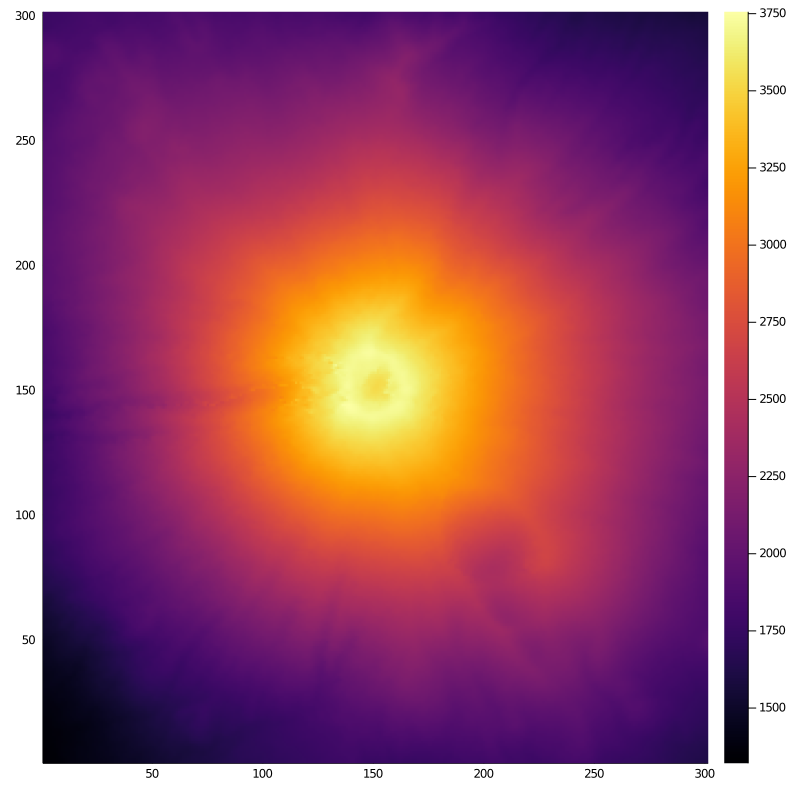

In [37]:
heatmap(sliced_data,
        size = (800, 800),
)